# Libraries

In [1]:
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cv2
from tqdm.autonotebook import tqdm
from sklearn.model_selection import train_test_split
from glob import glob
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision
import fnmatch
import json
import matplotlib.pyplot as plt
from PIL import Image
import os
import gc
from torch.optim import Adam
from torchsummary import summary
from tqdm import tqdm
import albumentations as A
from albumentations.pytorch import ToTensorV2
import torch.optim as optim
import segmentation_models_pytorch as smp

seed = 42

In [2]:
""" from google.colab import drive
drive.mount('/content/drive') """

" from google.colab import drive\ndrive.mount('/content/drive') "

In [3]:
""" import os
os.chdir('/content/drive/MyDrive/newspaper') """

" import os\nos.chdir('/content/drive/MyDrive/newspaper') "

In [4]:
""" path = f'/content/drive/MyDrive/newpaper/seg_model.pth' """

" path = f'/content/drive/MyDrive/newpaper/seg_model.pth' "

In [5]:
path = 'best_model.pth'

# Dataset

## Dataload

In [6]:
class MyDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform
        self.samples = []
        index=0
        for file_name in os.listdir(image_dir):
            if file_name.endswith('.jpg'):
                image_path = os.path.join(image_dir, file_name)
                # mask is in png format
                file_name = file_name.replace('.jpg', '.png')
                mask_path = os.path.join(mask_dir, file_name)
                sample = (image_path, mask_path)
                if os.path.exists(mask_path):
                  self.samples.append(sample)
                  index=index+1
                if index==10000:
                  break

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        image_path, mask_path = self.samples[idx]
        image = Image.open(image_path).convert("RGB")
        mask = Image.open(mask_path)

        image = np.array(image)
        mask = np.array(mask)

        if self.transform:
            aug = self.transform(image=image, mask=mask)
            image = aug['image']
            mask = aug['mask']

        return image, mask

In [7]:
al_t = A.Compose([
    A.Resize(256, 256),
    A.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)),
    ToTensorV2()
])
al_t_norm = A.Compose([
    A.Resize(256, 256),
    A.augmentations.transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)),
    ToTensorV2()
])

In [8]:
transform = al_t # tv_t, tv_t_norm, al_t, al_t_norm
batch_size=8
mask_dir_string = 'masksSC' # 'masksSC', 'masksRGB', 'masksNPY', 'masksONE'

train_dataset = MyDataset(image_dir='train/images', mask_dir=f'train/{mask_dir_string}', transform=transform)
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4) #nm = 4 para linux

test_dataset = MyDataset(image_dir='test/images', mask_dir=f'test/{mask_dir_string}', transform=transform)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4) #nm = 4 para linux

## Dictionaries and function for unique values

In [9]:
class_dict = {
    0: 'background',
    1: 'opinión',
    2: 'política',
    3: 'portada',
    4: 'economía',
    5: 'sociedad',
    6: 'en portada',
    7: 'deportes',
    8: 'mundo',
    9: 'ocio y cultura',
    10: 'otros'
}

In [10]:
rgb_dict = {
    0: [0, 0, 0],
    1: [0, 0, 255],
    2: [0, 255, 0],
    3: [0, 255, 255],
    4: [255, 0, 0],
    5: [255, 0, 255],
    6: [255, 255, 0],
    7: [255, 255, 255],
    8: [128, 128, 128],
    9: [128, 128, 0],
    10: [128, 0, 128],
}

In [11]:
dict_rgb_class = {
    (0, 0, 0): 'background', 
    (0, 0, 255): 'opinión', 
    (0, 255, 0): 'política', 
    (0, 255, 255): 'portada', 
    (255, 0, 0): 'economía', 
    (255, 0, 255): 'sociedad', 
    (255, 255, 0): 'en portada', 
    (255, 255, 255): 'deportes', 
    (128, 128, 128): 'mundo', 
    (128, 128, 0): 'ocio y cultura', 
    (128, 0, 128): 'otros'
}

In [12]:
def get_mask_unique_values(mask):

    if mask.shape == (256,256,3):
        value_counts = np.unique(mask.reshape(-1,3), axis=0, return_counts=True)
    elif mask.shape == (256,256):
        value_counts = np.unique(mask, return_counts=True)

    value_counts = (value_counts[0], 100*value_counts[1]/np.sum(value_counts[1]))

    # convert value_counts to int
    value_counts = (value_counts[0].astype(int), value_counts[1].astype(int))

    #print(f"\nClasses present in the mask: ")
    for i in range(len(value_counts[0])):
        class_name = dict_rgb_class[tuple(value_counts[0][i])]
        percentage = value_counts[1][i]
        print(f" -{class_name}: {percentage}%")

## Visualize samples

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


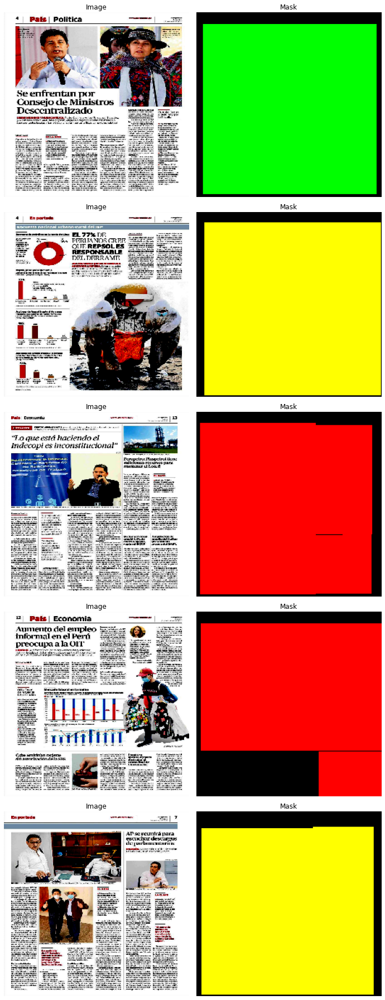

In [13]:
def visualize_samples(dataset, num_samples=5):
    fig, axs = plt.subplots(num_samples, 2, figsize=(10, num_samples * 5))

    for i in range(num_samples):
        image, mask = dataset[i]

        axs[i, 0].imshow(image.permute(1, 2, 0))  # Convert from (C, H, W) to (H, W, C)
        axs[i, 0].set_title("Image")
        axs[i, 0].axis('off')

        colored_mask = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)
        for label, color in rgb_dict.items():
            colored_mask[mask == label] = color

        axs[i, 1].imshow(colored_mask)
        axs[i, 1].set_title("Mask")
        axs[i, 1].axis('off')


    plt.tight_layout()
    plt.show()
visualize_samples(train_dataset)

# Arquitecture

In [15]:
# Model
model = smp.Unet(encoder_name="resnet50", encoder_weights="imagenet", in_channels=3, classes=11)
device_info = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device = device_info
model.to(device_info)

RuntimeError: CUDA error: out of memory
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.


In [50]:
# Class weights
class_weights = torch.tensor([1, 1, 1, 1, 1, 1, 1, 2, 3, 4, 1], dtype=torch.float,device=device_info)
loss_fn = nn.CrossEntropyLoss(weight=class_weights)

In [51]:
# Optimizer
def get_optimizer(name="Adam"):
    if name == "Adam":
        return optim.Adam(model.parameters(), lr=1e-3)
    if name == "AdamW":
        return optim.AdamW(model.parameters(), lr=1e-3)
    if name == "Ranger":
        from pytorch_ranger import Ranger
        return Ranger(model.parameters(), lr=1e-3)

In [52]:
# Scheduler
def get_scheduler(name, optimizer):
    if name == "ReduceLROnPlateau":
        return optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True, eps=1e-6)
    if name == "StepLR":
        return optim.lr_scheduler.StepLR(optimizer, step_size=2, gamma=0.1)
    if name == "OneCycleLR":
        return optim.lr_scheduler.OneCycleLR(optimizer, max_lr=1e-3, steps_per_epoch=len(train_dataloader), epochs=10)
    if name == "CyclicLR":
        return optim.lr_scheduler.CyclicLR(optimizer, base_lr=1e-3, max_lr=1e-2, step_size_up=1000, mode="triangular2")
    if name == "CosineAnnealingLR":
        return optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=10, eta_min=1e-6)


In [53]:
# AdamW, CosineAnnealingLR

optimizer = get_optimizer("AdamW") # Adam, AdamW, Ranger
scheduler = get_scheduler("CosineAnnealingLR", optimizer) # ReduceLROnPlateau, StepLR, OneCycleLR, CyclicLR, CosineAnnealingLR
model.to(device_info)

Unet(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
      

## Load saved model

In [16]:
path = 'best_model_v3.pth'

In [17]:
device = device_info
model.load_state_dict(torch.load(path))

<All keys matched successfully>

# Training

In [14]:
model = smp.Unet(encoder_name="resnet50", encoder_weights="imagenet", in_channels=3, classes=11)
device_info = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# loss_fn = smp.losses.DiceLoss(smp.losses.MULTICLASS_MODE)
class_weights = torch.tensor([1, 1, 1, 1, 1, 1, 1, 2, 3, 4, 1], dtype=torch.float,device=device_info)

# Define Cross-Entropy Loss with weighted class
loss_fn = nn.CrossEntropyLoss(weight=class_weights)
optimizer = optim.AdamW(model.parameters(), lr=1e-3)

RuntimeError: CUDA error: out of memory
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.


In [83]:
# Training function
def train_model(model, train_loader, val_loader, loss_fn, optimizer, num_epochs=40, device=device_info):
    model = model.to(device)
    best_loss = float('inf')
    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        for images, masks in train_loader:
            images, masks = images.to(device), masks.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = loss_fn(outputs, masks.long())
            loss.backward()
            optimizer.step()
            train_loss += loss.item()

        val_loss = 0
        model.eval()
        with torch.no_grad():
            for images, masks in val_loader:
                images, masks = images.to(device), masks.to(device)
                outputs = model(images)
                loss = loss_fn(outputs, masks.long())
                val_loss += loss.item()

        train_loss /= len(train_loader)
        val_loss /= len(val_loader)

        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}")

        # Step the scheduler
        #scheduler.step(val_loss)

        # Save the model if validation loss decreases
        if val_loss < best_loss:
            best_loss = val_loss
            torch.save(model.state_dict(), 'best_model.pth')
            print("Model saved!")

# Train the model
train_model(model, train_dataloader, test_dataloader, loss_fn, optimizer, num_epochs=50,device=device_info)

Epoch 1/50, Train Loss: 1.7540, Validation Loss: 1.5442
Model saved!
Epoch 2/50, Train Loss: 1.5819, Validation Loss: 1.2598
Model saved!


Epoch 3/50, Train Loss: 1.4378, Validation Loss: 1.3021
Epoch 4/50, Train Loss: 1.3073, Validation Loss: 1.0488
Model saved!
Epoch 5/50, Train Loss: 1.1744, Validation Loss: 0.9952
Model saved!
Epoch 6/50, Train Loss: 1.1015, Validation Loss: 0.9214
Model saved!
Epoch 7/50, Train Loss: 1.0528, Validation Loss: 0.8768
Model saved!
Epoch 8/50, Train Loss: 1.0252, Validation Loss: 0.8534
Model saved!
Epoch 9/50, Train Loss: 0.9698, Validation Loss: 0.9261
Epoch 10/50, Train Loss: 0.9295, Validation Loss: 0.7825
Model saved!
Epoch 11/50, Train Loss: 0.9151, Validation Loss: 0.7701
Model saved!
Epoch 12/50, Train Loss: 0.8784, Validation Loss: 0.8348
Epoch 13/50, Train Loss: 0.8516, Validation Loss: 0.7160
Model saved!


## Visualize predictions

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


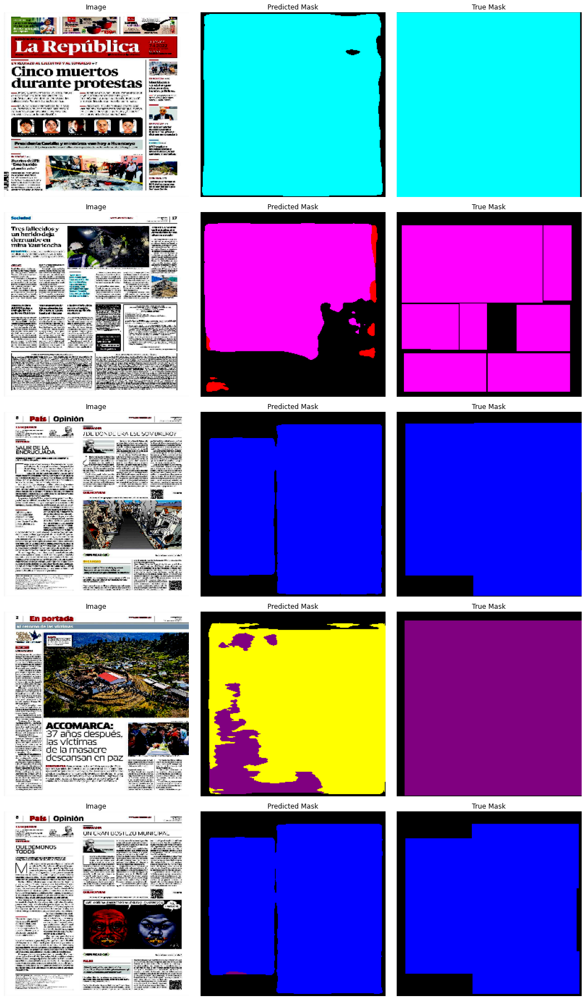

In [57]:
# Function to visualize predictions
def visualize_predictions(model, dataset, num_samples=5, device='cuda'):
    model.eval()
    model.to(device)
    fig, axs = plt.subplots(num_samples, 3, figsize=(15, num_samples * 5))

    for i in range(num_samples):
        image, mask = dataset[i]
        image = image.unsqueeze(0).to(device)  # Add batch dimension and move to device

        with torch.no_grad():
            pred_mask = model(image).argmax(dim=1).squeeze().cpu().numpy()

        axs[i, 0].imshow(image.squeeze().permute(1, 2, 0).cpu().numpy())
        axs[i, 0].set_title("Image")
        axs[i, 0].axis('off')

        colored_pred_mask = np.zeros((pred_mask.shape[0], pred_mask.shape[1], 3), dtype=np.uint8)
        for label, color in rgb_dict.items():
            colored_pred_mask[pred_mask == label] = color

        axs[i, 1].imshow(colored_pred_mask)
        axs[i, 1].set_title("Predicted Mask")
        axs[i, 1].axis('off')

        colored_true_mask = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)
        for label, color in rgb_dict.items():
            colored_true_mask[mask == label] = color

        axs[i, 2].imshow(colored_true_mask)
        axs[i, 2].set_title("True Mask")
        axs[i, 2].axis('off')

    plt.tight_layout()
    plt.show()

# Assuming test_dataset is defined somewhere in your code
visualize_predictions(model, test_dataset)

# Metrics

## Jaccard

In [18]:
def jaccard_metric(loader, model):
    model.eval()
    jaccard = 0
    num_correct = 0
    num_pixels = 0

    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            preds = outputs.argmax(dim=1)
            num_correct += (preds == masks).sum().item()
            num_pixels += torch.numel(preds)

            for pred, true in zip(preds, masks):
                intersection = torch.logical_and(pred, true).sum().item()
                union = torch.logical_or(pred, true).sum().item()
                jaccard += intersection / union

    print(f"Got {num_correct}/{num_pixels} with accuracy {num_correct/num_pixels*100:.2f}")
    print(f"Jaccard: {jaccard/len(loader)}")
    model.train()


In [19]:
print("TRAIN")
jaccard_metric(train_dataloader, model)

print(f'\nTEST')
jaccard_metric(test_dataloader, model)

TRAIN
Got 206780477/234160128 with accuracy 88.31
Jaccard: 7.649425035373335

TEST
Got 22866133/25952256 with accuracy 88.11
Jaccard: 7.592156624476331


## Dice

In [20]:
def dice_metric(loader, model):
    model.eval()
    dice_score = 0
    num_correct = 0
    num_pixels = 0

    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            preds = outputs.argmax(dim=1)
            num_correct += (preds == masks).sum().item()
            num_pixels += torch.numel(preds)

            for pred, true in zip(preds, masks):
                intersection = torch.logical_and(pred, true).sum().item()
                dice_score += (2. * intersection) / (pred.sum().item() + true.sum().item())

    print(f"Got {num_correct}/{num_pixels} with accuracy {num_correct/num_pixels*100:.2f}")
    print(f"Dice Score: {dice_score/len(loader)}")
    model.train()
    

In [21]:
print("TRAIN")
dice_metric(train_dataloader, model)

print(f'\nTEST')
dice_metric(test_dataloader, model)

TRAIN
Got 206780479/234160128 with accuracy 88.31
Dice Score: 3.154576932423158

TEST
Got 22866133/25952256 with accuracy 88.11
Dice Score: 3.1834346259054995


## Confusion Matrix

In [22]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

def plot_confusion_matrix(loader, model):
    model.eval()
    all_preds = []
    all_masks = []

    with torch.no_grad():
        for images, masks in loader:
            images, masks = images.to(device), masks.to(device)
            outputs = model(images)
            preds = outputs.argmax(dim=1)
            all_preds.extend(preds.view(-1).cpu().numpy())
            all_masks.extend(masks.view(-1).cpu().numpy())

    cm = confusion_matrix(all_masks, all_preds)
    cm = cm / cm.sum(axis=1)[:,None]
    plt.figure(figsize=(10, 10))
    sns.heatmap(cm, annot=True, fmt='.2f', cmap='Blues', xticklabels=class_dict.values(), yticklabels=class_dict.values())
    plt.xlabel('Predicted')
    plt.ylabel('Target')
    plt.title('Confusion Matrix')
    plt.show()


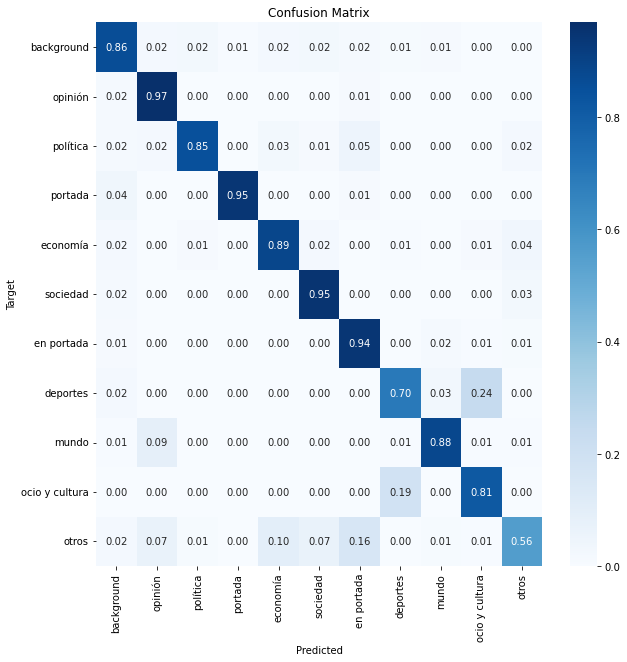

In [23]:
plot_confusion_matrix(test_dataloader, model)

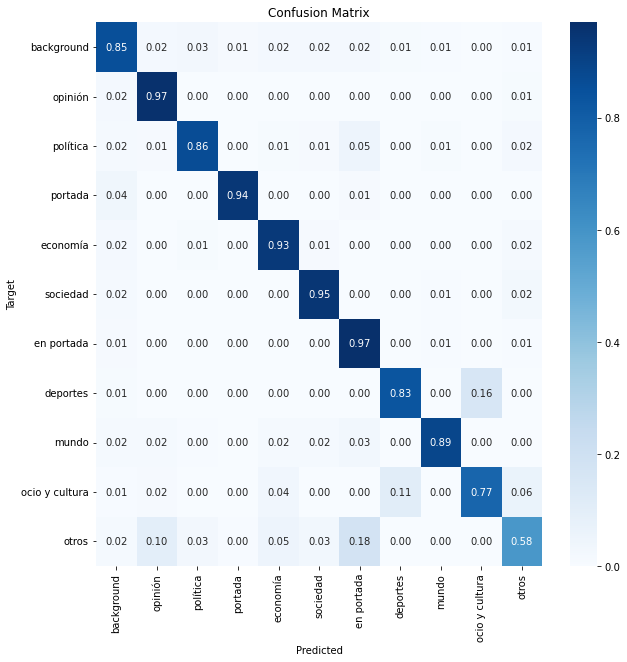

In [24]:
plot_confusion_matrix(train_dataloader, model)

# Testing

## Functions

In [25]:
# To iterate through all the files with the extension 'pattern' in a given directory
def find_files(directory, pattern):
    for root, dirs, files in os.walk(directory):
        for basename in files:
            if fnmatch.fnmatch(basename, pattern):
                filename = os.path.join(root, basename)
                yield filename

In [26]:
def improve_single_prediction(prediction):
    
    if prediction.shape == (256,256,3):
        value_counts = np.unique(prediction.reshape(-1,3), axis=0, return_counts=True)
    elif prediction.shape == (256,256):
        value_counts = np.unique(prediction, return_counts=True)

    value_counts = (value_counts[0], 100*value_counts[1]/np.sum(value_counts[1]))

    high_count_index = np.argmax(value_counts[1])
    high_count_class = value_counts[0][high_count_index]
    high_count = value_counts[1][high_count_index]

    low_count_threshold = 20
    lowest_count_threshold = 5

    for i in range(len(value_counts[0])):
        condition_1 = value_counts[1][i] < low_count_threshold and high_count > 50 and value_counts[0][i] != 0
        condition_2 = value_counts[1][i] < lowest_count_threshold and value_counts[0][i] != 0
        if condition_1 or condition_2:
            prediction[prediction == value_counts[0][i]] = high_count_class
            # Print the replaced class
            #print(f"      {class_dict[value_counts[0][i]]} replaced by {class_dict[high_count_class]}")


    return prediction

In [27]:
# Not true mask needed
def predict_single_image(image_path, model, improve=True):
    model.eval()
    image = Image.open(image_path)
    image = np.array(image)
    image = transform(image=image)['image']
    image = image.unsqueeze(0).to(device)
    
    with torch.no_grad():
        pred_mask = model(image).argmax(dim=1).squeeze().cpu().numpy()

    if(improve):
        pred_mask = improve_single_prediction(pred_mask)

    colored_pred_mask = np.zeros((pred_mask.shape[0], pred_mask.shape[1], 3), dtype=np.uint8)
    for label, color in rgb_dict.items():
        colored_pred_mask[pred_mask == label] = color

    return image, colored_pred_mask

In [28]:
# Predicts the first 'show_first' images in the directory (true mask needed)
def predict_images_in_directory_2(directory, model=model, show_first=10):

    if not os.path.exists(directory):
        print(f"Directory '{directory}' not found")
        return

    images_found = len(list(find_files(directory, '*.jpg')))
    if images_found == 0:
        print(f"No images found in directory '{directory}'")
        return

    # print number of images found
    print(f"Found {images_found} images in directory '{directory}'")

    if images_found > show_first:
        print(f"Showing the first {show_first} images")
    else:
        show_first = images_found

    fig, axs = plt.subplots(show_first, 3, figsize=(15, show_first * 5))
    i = 0

    for image_path in find_files(directory, '*.jpg'):

        image, pred_mask = predict_single_image(image_path, model)
        image = image.squeeze().permute(1, 2, 0).cpu().numpy()
        

        last_path = image_path.split('/')[-1].replace('.jpg', '.png')
        truth_path = 'test/masksRGB/' + last_path
        truth = Image.open(truth_path)

        # Resizing
        #image_resized = cv2.resize(image, (ancho_px_show, altura_px_show))
        #pred_mask_resized = cv2.resize(pred_mask, (ancho_px_show, altura_px_show))
        #truth_resized = cv2.resize(np.array(truth), (ancho_px_show, altura_px_show))


        # Plotting
        axs[i, 0].imshow(image)
        axs[i, 0].set_title("Image")
        axs[i, 0].axis('off')

        axs[i, 1].imshow(pred_mask)
        axs[i, 1].set_title("Predicted Mask")
        axs[i, 1].axis('off')

        axs[i, 2].imshow(truth)
        axs[i, 2].set_title("True Mask")
        axs[i, 2].axis('off')

        i += 1

        if i == show_first:
            break

    plt.tight_layout()
    plt.show()


## Single prediction

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 14%
 -sociedad: 85%


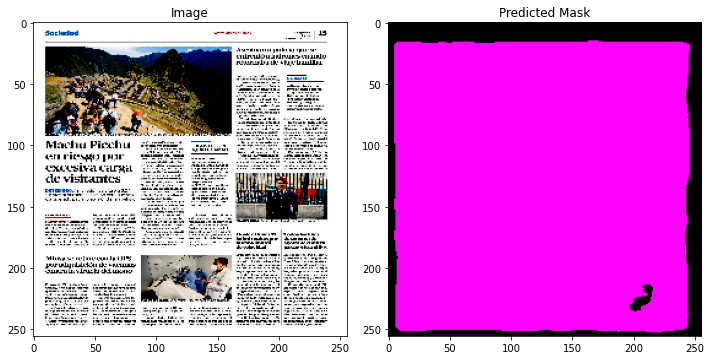

In [29]:
image_path = 'test_image3.jpg' # any image path

image, prediction = predict_single_image(image_path, model)

fig, axs = plt.subplots(1, 2, figsize=(2 * 5, 1 * 5))

axs[0].imshow(image.squeeze().permute(1, 2, 0).cpu().numpy())
axs[0].set_title("Image")

axs[1].imshow(prediction)
axs[1].set_title("Predicted Mask")

get_mask_unique_values(prediction)

plt.tight_layout()
plt.show()


## Per category

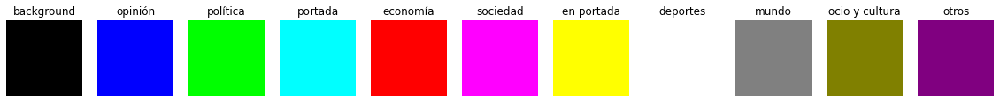

In [30]:
fig, ax = plt.subplots(1, 11, figsize=(20, 20))
for i in range(11):
    ax[i].imshow(np.array([[rgb_dict[i]]]))
    ax[i].axis('off')
    ax[i].set_title(class_dict[i])

### 1: 'opinión'

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Found 10 images in directory 'classes/1'


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


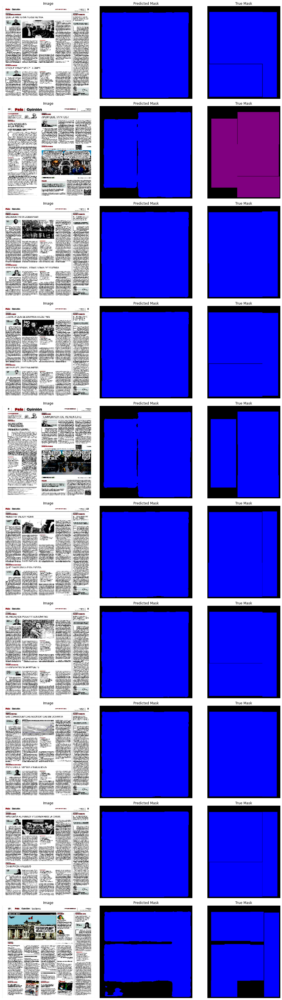

In [31]:
dir_1 = 'classes/1'

predict_images_in_directory_2(dir_1, model)

### 2: 'política'

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Found 10 images in directory 'classes/2'


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


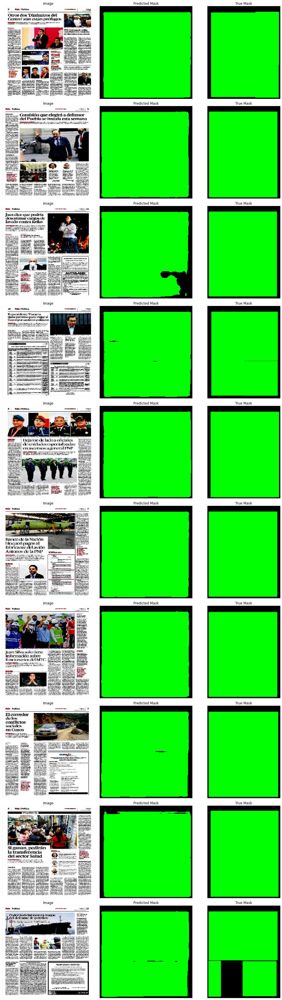

In [32]:
dir_2 = 'classes/2'

predict_images_in_directory_2(dir_2, model)

### 3: 'portada'

Found 10 images in directory 'classes/3'


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

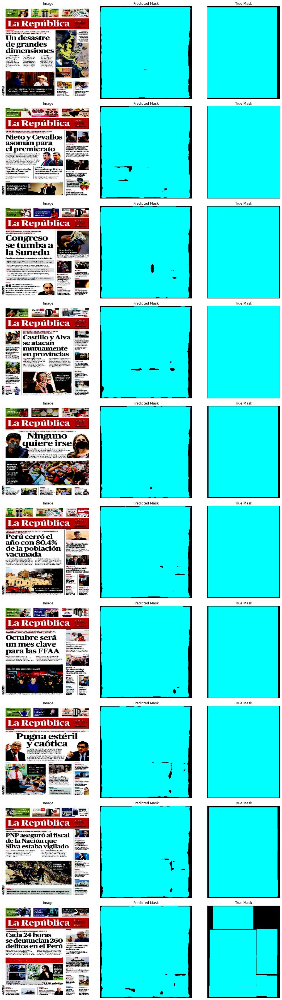

In [33]:
dir_3 = 'classes/3'

predict_images_in_directory_2(dir_3, model)

### 4: 'economía'

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Found 10 images in directory 'classes/4'


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


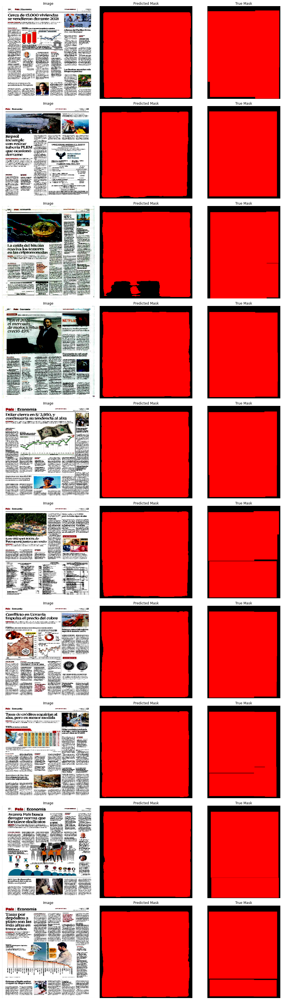

In [34]:
dir_4 = 'classes/4'

predict_images_in_directory_2(dir_4, model)

### 5: 'sociedad'

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Found 10 images in directory 'classes/5'


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


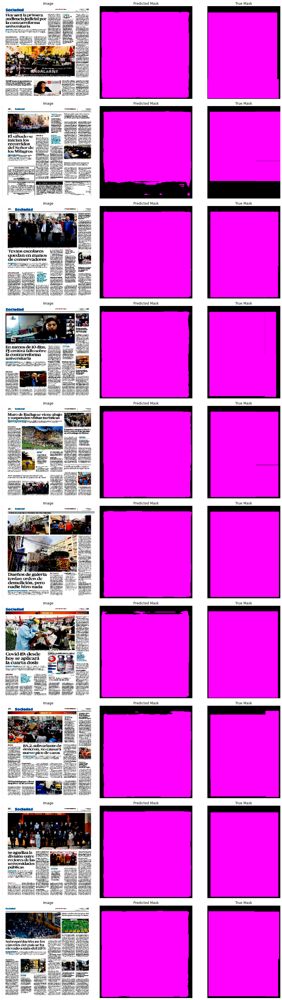

In [35]:
dir_5 = 'classes/5'

predict_images_in_directory_2(dir_5, model)

### 6: 'en portada'

Found 10 images in directory 'classes/6'


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

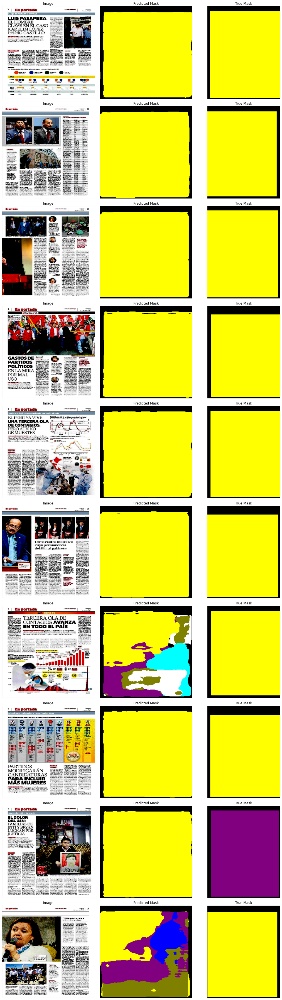

In [36]:
dir_6 = 'classes/6'

predict_images_in_directory_2(dir_6, model)

### 7: 'deportes'

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Found 6 images in directory 'classes/7'


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


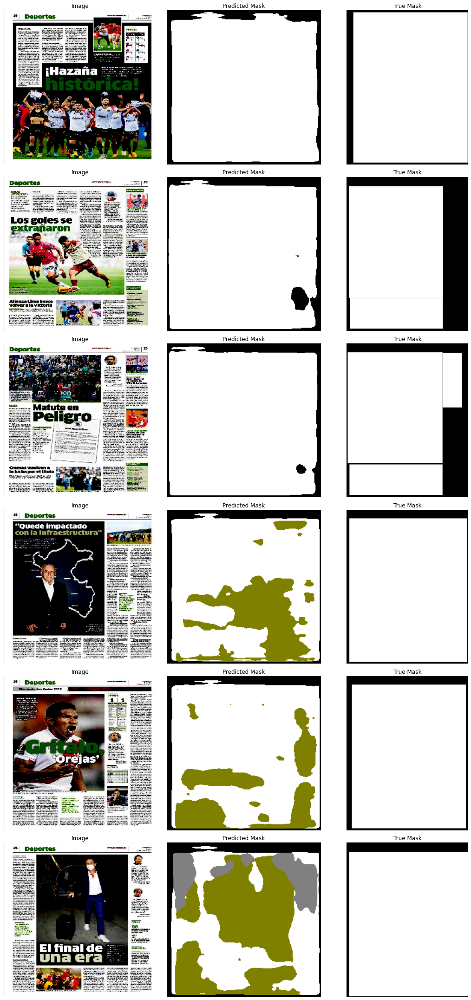

In [37]:
dir_7 = 'classes/7'

predict_images_in_directory_2(dir_7, model)

### 8: 'mundo'

Found 10 images in directory 'classes/8'


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

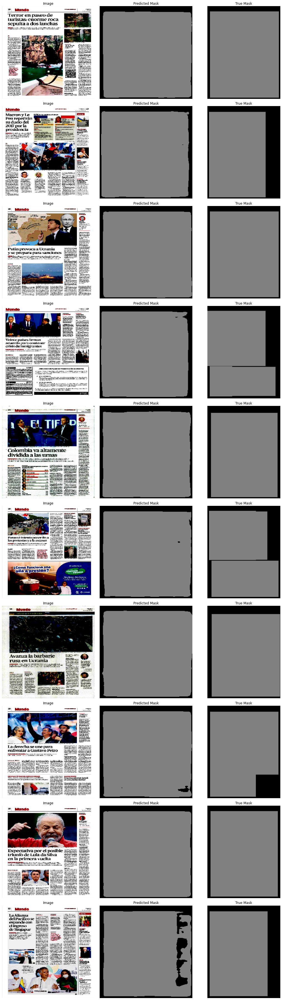

In [38]:
dir_8 = 'classes/8'

predict_images_in_directory_2(dir_8, model)

### 9: 'ocio y cultura'

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Found 2 images in directory 'classes/9'


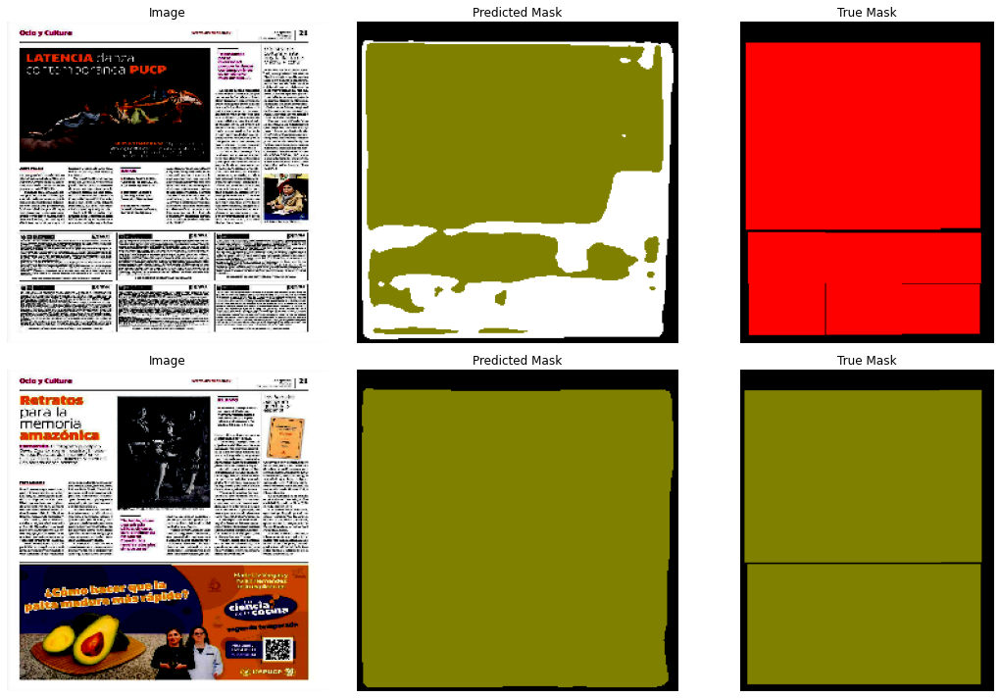

In [39]:
dir_9 = 'classes/9'

predict_images_in_directory_2(dir_9, model)

## Per directory

In [40]:
directory = 'new/2021/10/03/la república (lima, perú)/'

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 14%
 -política: 85%


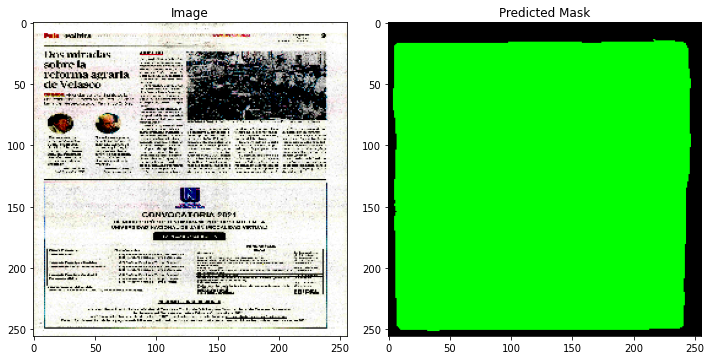

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 10%
 -en portada: 89%


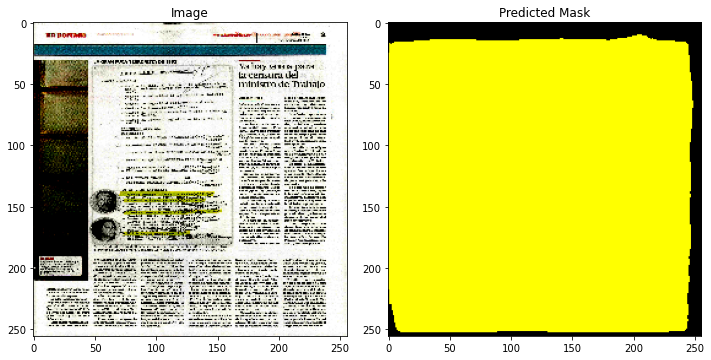

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 13%
 -política: 86%


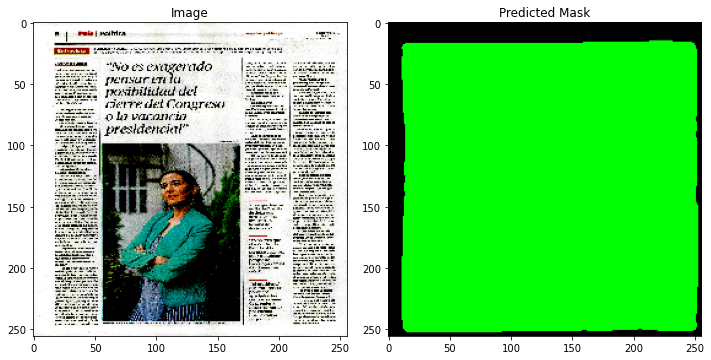

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 15%
 -sociedad: 84%


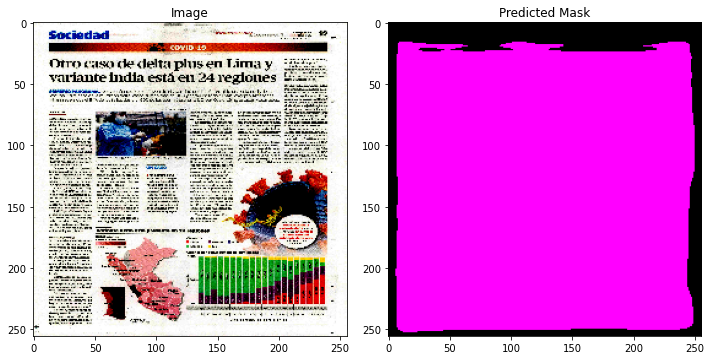

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 14%
 -otros: 33%
 -economía: 52%


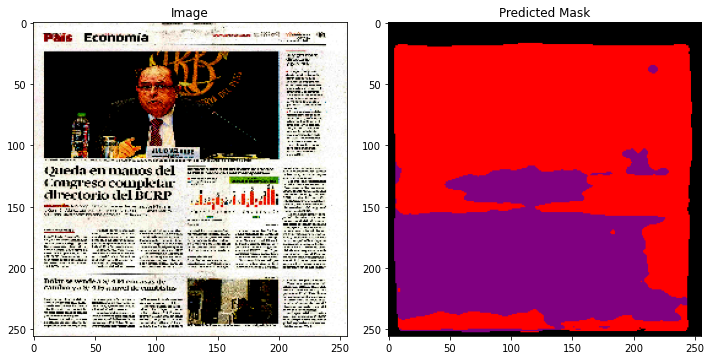

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 13%
 -otros: 86%


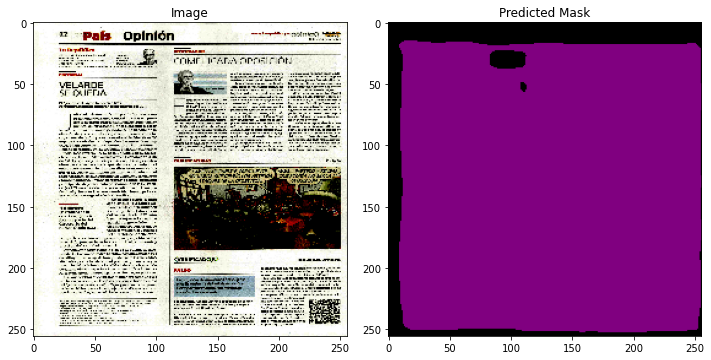

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 14%
 -otros: 27%
 -sociedad: 58%


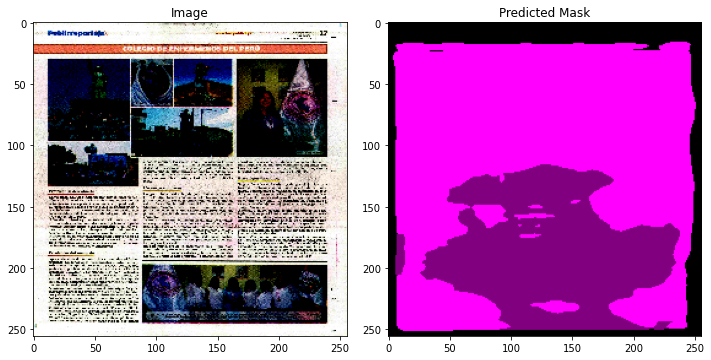

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 13%
 -política: 86%


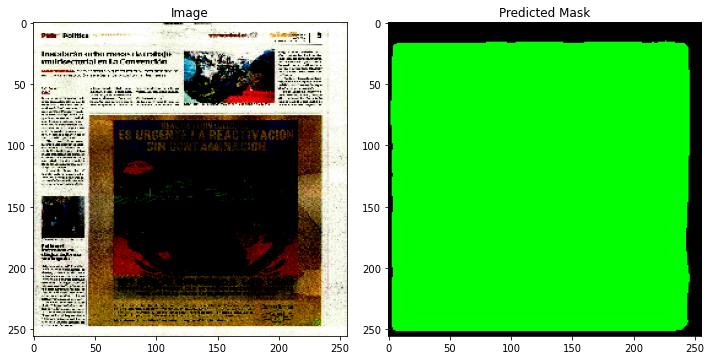

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 11%
 -en portada: 88%


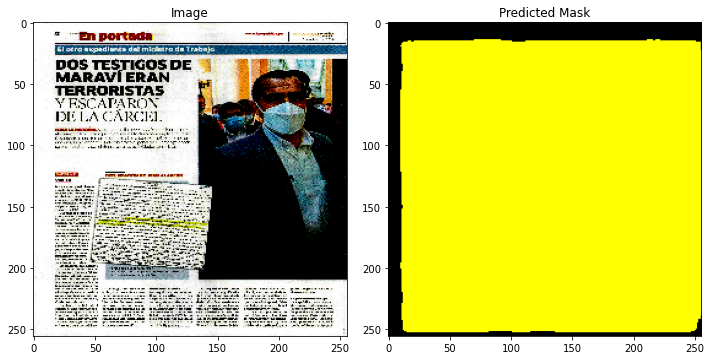

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 11%
 -ocio y cultura: 88%


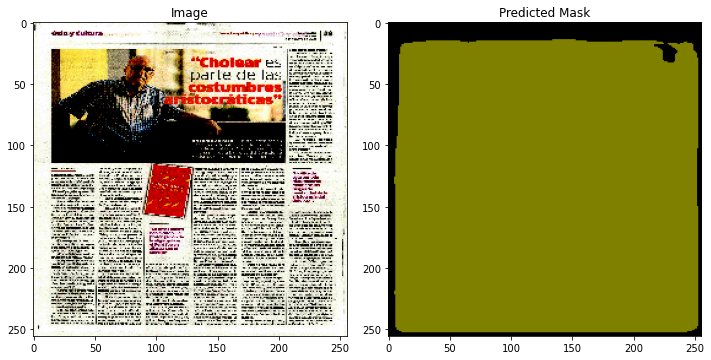

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 14%
 -otros: 63%
 -ocio y cultura: 21%


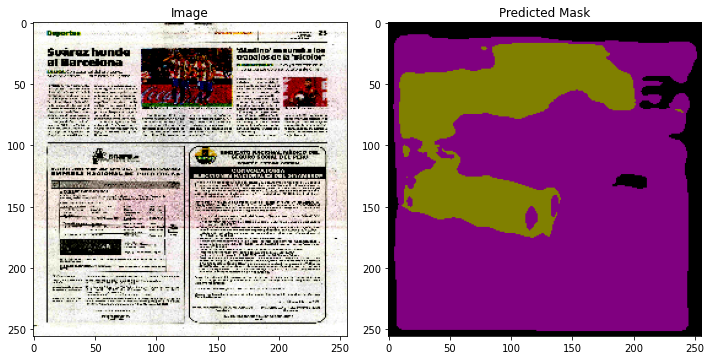

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 13%
 -política: 86%


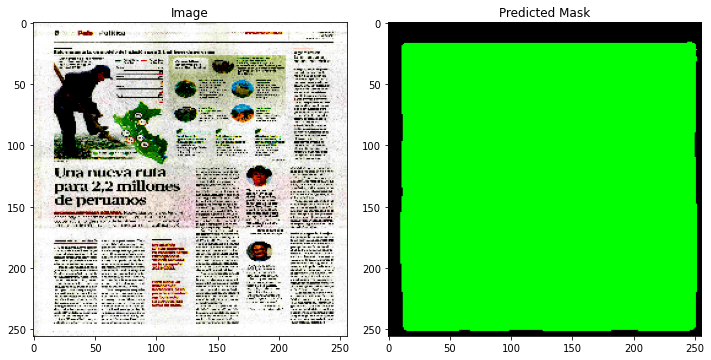

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 13%
 -sociedad: 86%


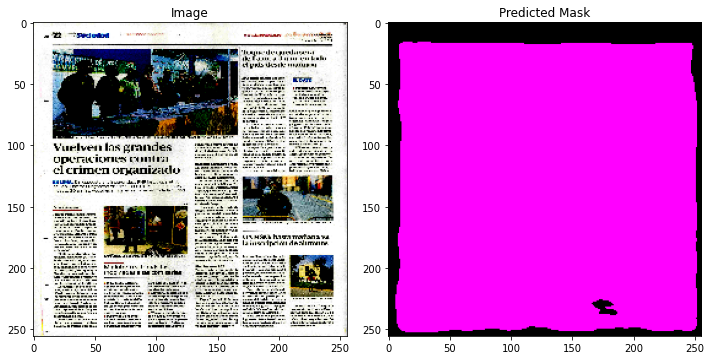

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 6%
 -portada: 93%


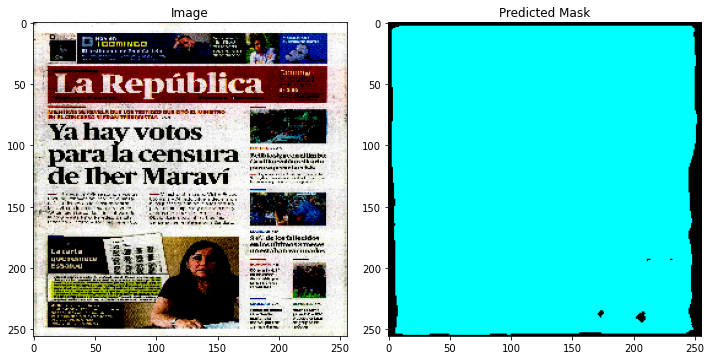

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 13%
 -otros: 10%
 -ocio y cultura: 46%
 -en portada: 21%
 -deportes: 8%


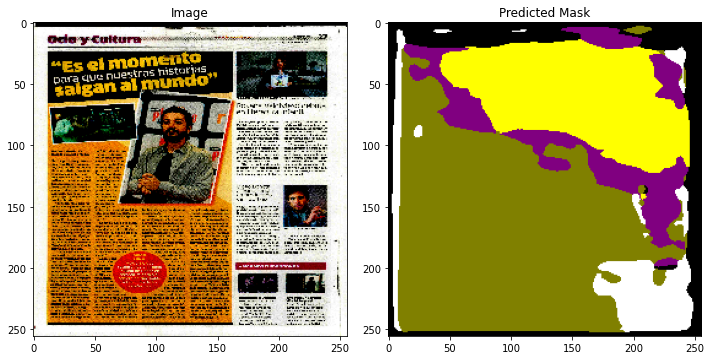

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 14%
 -otros: 63%
 -sociedad: 22%


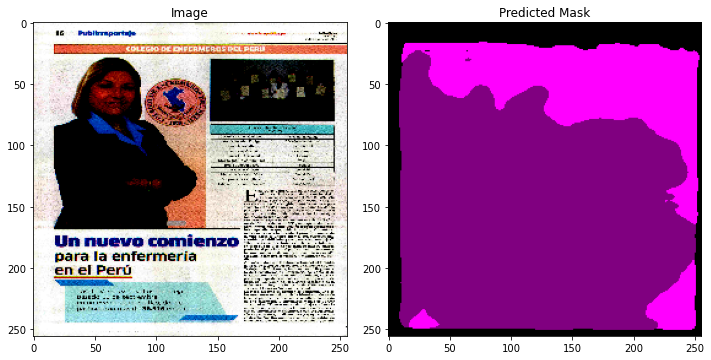

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 14%
 -otros: 51%
 -economía: 34%


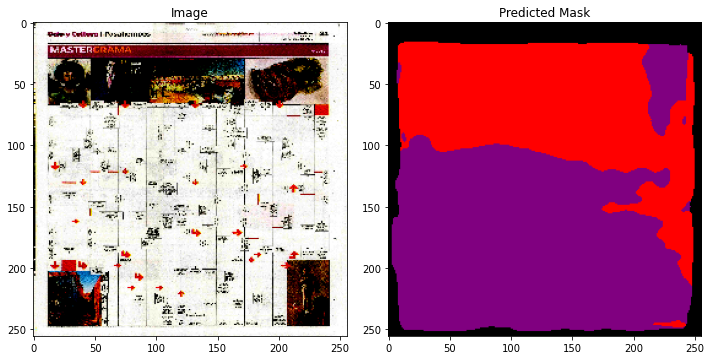

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 11%
 -ocio y cultura: 49%
 -deportes: 38%


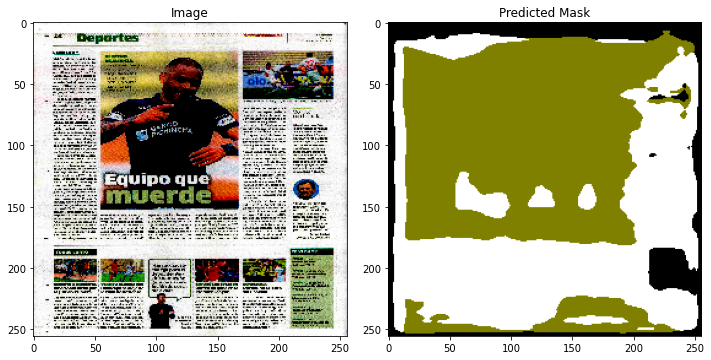

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 9%
 -otros: 90%


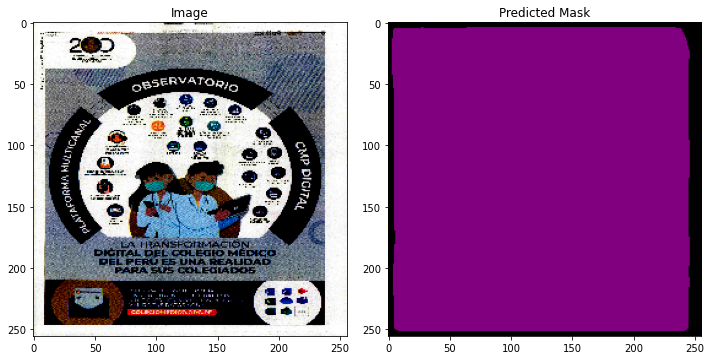

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 15%
 -política: 51%
 -otros: 32%


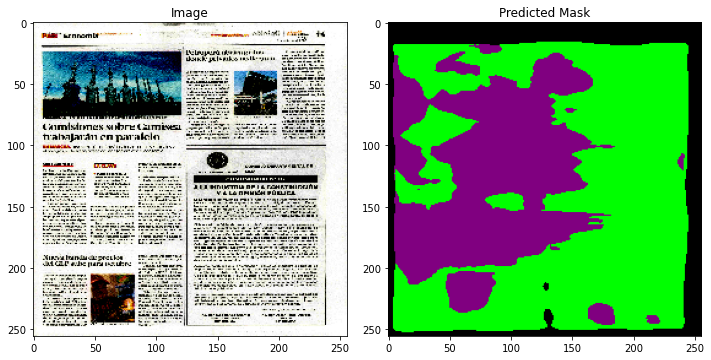

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 7%
 -otros: 37%
 -ocio y cultura: 22%
 -en portada: 26%
 -deportes: 5%


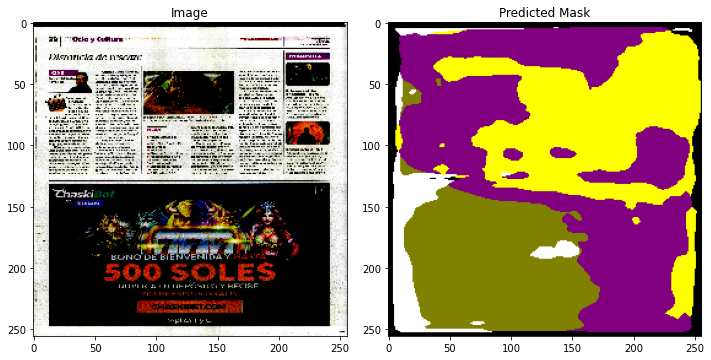

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 14%
 -sociedad: 85%


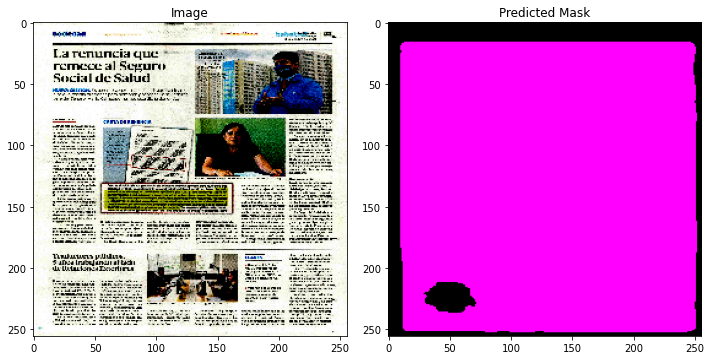

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 13%
 -política: 24%
 -otros: 62%


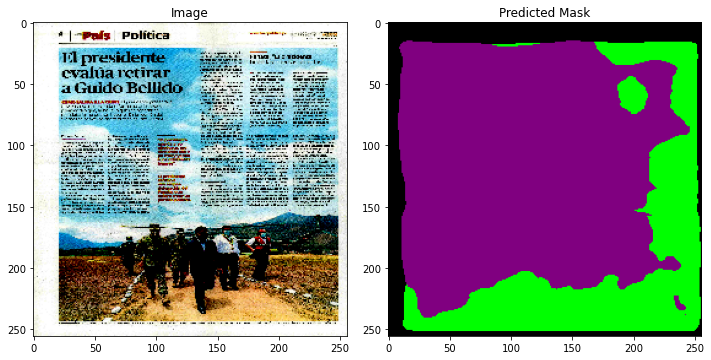

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 13%
 -sociedad: 86%


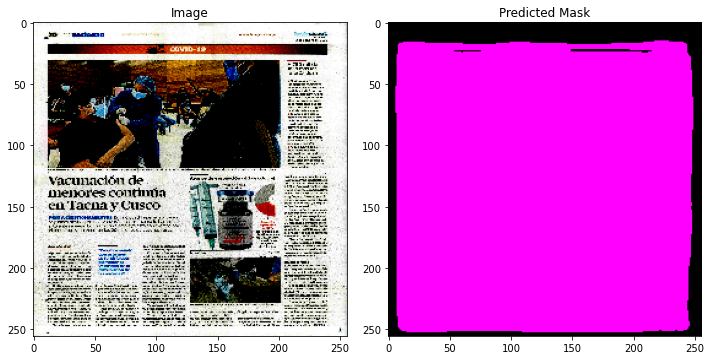

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 17%
 -opinión: 13%
 -otros: 38%
 -economía: 30%


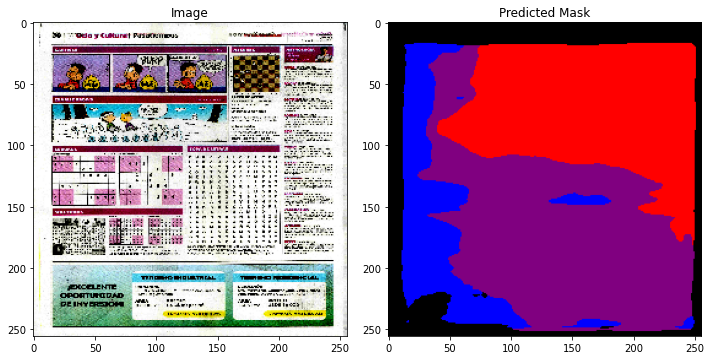

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 9%
 -otros: 90%


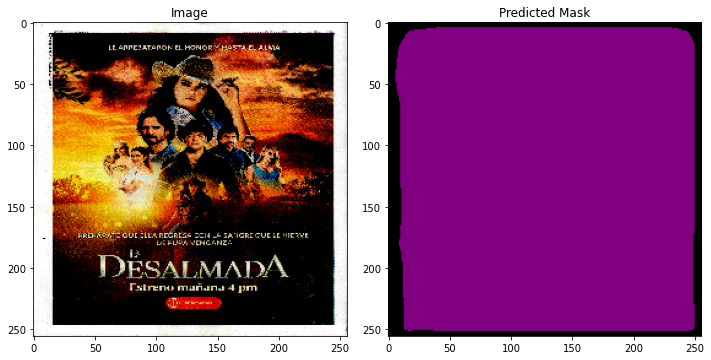

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 13%
 -opinión: 86%


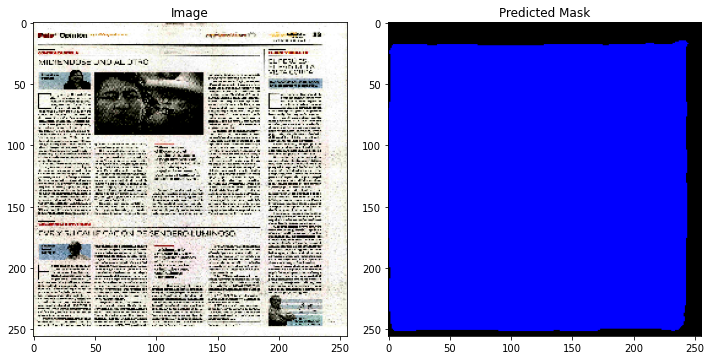

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 13%
 -otros: 86%


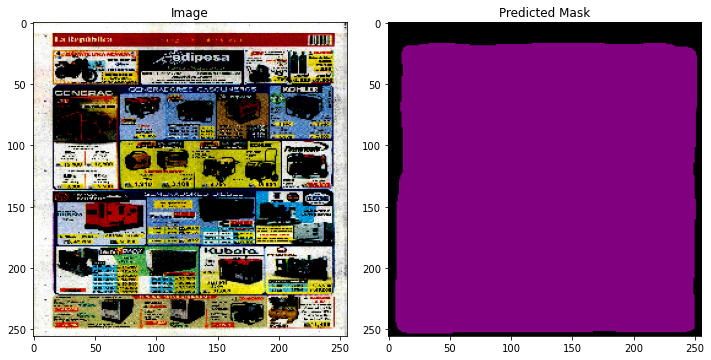

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 13%
 -política: 86%


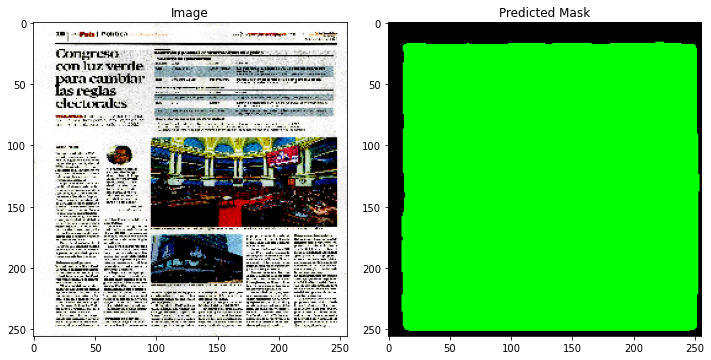

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 15%
 -opinión: 84%


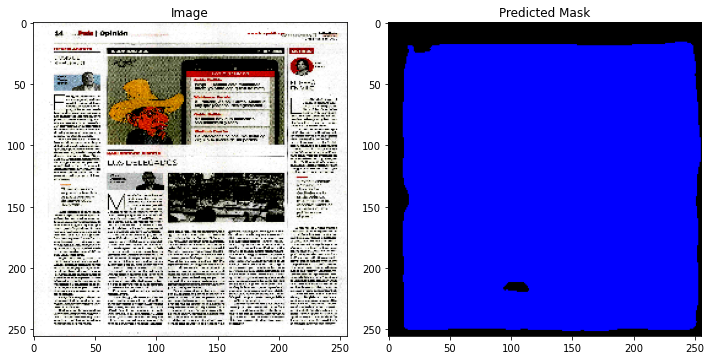

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 19%
 -mundo: 80%


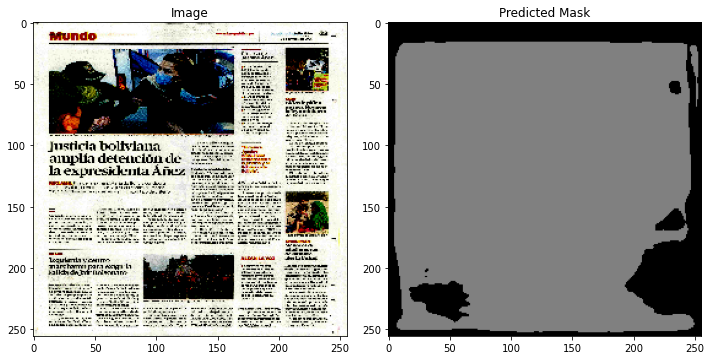

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 -background: 18%
 -política: 19%
 -otros: 38%
 -economía: 23%


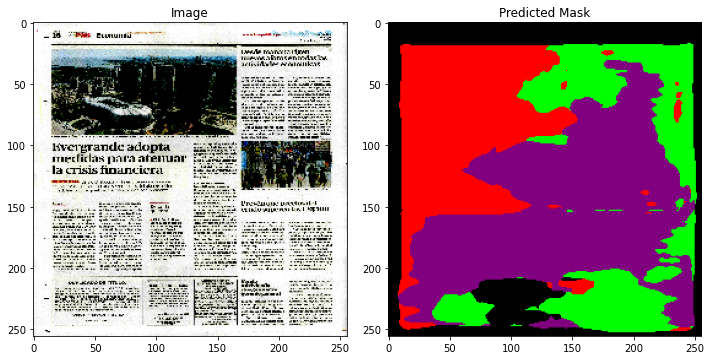

In [41]:
for filename in find_files(directory, '*.jpg'):
    image, prediction = predict_single_image(filename, model)

    fig, axs = plt.subplots(1, 2, figsize=(2 * 5, 1 * 5))

    axs[0].imshow(image.squeeze().permute(1, 2, 0).cpu().numpy())
    axs[0].set_title("Image")

    axs[1].imshow(prediction)
    axs[1].set_title("Predicted Mask")

    get_mask_unique_values(prediction)

    plt.tight_layout()
    plt.show()